In [1]:
import numpy as np
from tensorflow.keras.datasets import imdb
from tensorflow.keras.preprocessing import sequence
import matplotlib.pyplot as plt
# load the dataset
(X_train, y_train), (X_test, y_test) = imdb.load_data()
X = np.concatenate((X_train, X_test), axis=0)
y = np.concatenate((y_train, y_test), axis=0)
...

Ellipsis

In [2]:
!pip install tensorflow


In [3]:
import tensorflow as tf

In [4]:
!pip install matplotlib


In [5]:
import numpy as np
from tensorflow.keras.datasets import imdb
import matplotlib.pyplot as plt
# load the dataset
(X_train, y_train), (X_test, y_test) = imdb.load_data()
X = np.concatenate((X_train, X_test), axis=0)
y = np.concatenate((y_train, y_test), axis=0)
...

Ellipsis

In [6]:
...
# summarize size
print("Training data: ")
print(X.shape)
print(y.shape)

Training data: 
(50000,)
(50000,)


In [7]:
...
# Summarize number of words
print("Number of words: ")
print(len(np.unique(np.hstack(X))))

Number of words: 
88585


In [8]:
...
# Summarize number of classes
print("Classes: ")
print(np.unique(y))

Classes: 
[0 1]


Review length: 
Mean 234.76 words (172.911495)


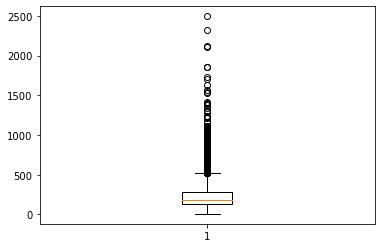

In [9]:
...
# Summarize review length
print("Review length: ")
result = [len(x) for x in X]
print("Mean %.2f words (%f)" % (np.mean(result), np.std(result)))
# plot review length
plt.boxplot(result)
plt.show()

In [10]:
...
imdb.load_data(nb_words=5000)

((array([list([1, 14, 22, 16, 43, 530, 973, 1622, 1385, 65, 458, 4468, 66, 3941, 4, 173, 36, 256, 5, 25, 100, 43, 838, 112, 50, 670, 2, 9, 35, 480, 284, 5, 150, 4, 172, 112, 167, 2, 336, 385, 39, 4, 172, 4536, 1111, 17, 546, 38, 13, 447, 4, 192, 50, 16, 6, 147, 2025, 19, 14, 22, 4, 1920, 4613, 469, 4, 22, 71, 87, 12, 16, 43, 530, 38, 76, 15, 13, 1247, 4, 22, 17, 515, 17, 12, 16, 626, 18, 2, 5, 62, 386, 12, 8, 316, 8, 106, 5, 4, 2223, 2, 16, 480, 66, 3785, 33, 4, 130, 12, 16, 38, 619, 5, 25, 124, 51, 36, 135, 48, 25, 1415, 33, 6, 22, 12, 215, 28, 77, 52, 5, 14, 407, 16, 82, 2, 8, 4, 107, 117, 2, 15, 256, 4, 2, 7, 3766, 5, 723, 36, 71, 43, 530, 476, 26, 400, 317, 46, 7, 4, 2, 1029, 13, 104, 88, 4, 381, 15, 297, 98, 32, 2071, 56, 26, 141, 6, 194, 2, 18, 4, 226, 22, 21, 134, 476, 26, 480, 5, 144, 30, 2, 18, 51, 36, 28, 224, 92, 25, 104, 4, 226, 65, 16, 38, 1334, 88, 12, 16, 283, 5, 16, 4472, 113, 103, 32, 15, 16, 2, 19, 178, 32]),
         list([1, 194, 1153, 194, 2, 78, 228, 5, 6, 1463, 4

In [11]:
...
X_train = sequence.pad_sequences(X_train, maxlen=500)
X_test = sequence.pad_sequences(X_test, maxlen=500)

In [12]:
...
Embedding(5000, 32, input_length=500)

NameError: name 'Embedding' is not defined

In [13]:
# MLP for the IMDB problem
from tensorflow.keras.datasets import imdb
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Embedding
from tensorflow.keras.preprocessing import sequence
# load the dataset but only keep the top n words, zero the rest
top_words = 5000
(X_train, y_train), (X_test, y_test) = imdb.load_data(num_words=top_words)
max_words = 500
X_train = sequence.pad_sequences(X_train, maxlen=max_words)
X_test = sequence.pad_sequences(X_test, maxlen=max_words)
# create the model
model = Sequential()
model.add(Embedding(top_words, 32, input_length=max_words))
model.add(Flatten())
model.add(Dense(250, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model.summary()
# Fit the model
model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=2, batch_size=128, verbose=2)
# Final evaluation of the model
scores = model.evaluate(X_test, y_test, verbose=0)
print("Accuracy: %.2f%%" % (scores[1]*100))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 500, 32)           160000    
                                                                 
 flatten (Flatten)           (None, 16000)             0         
                                                                 
 dense (Dense)               (None, 250)               4000250   
                                                                 
 dense_1 (Dense)             (None, 1)                 251       
                                                                 
Total params: 4,160,501
Trainable params: 4,160,501
Non-trainable params: 0
_________________________________________________________________
Epoch 1/2
196/196 - 21s - loss: 0.4688 - accuracy: 0.7501 - val_loss: 0.2894 - val_accuracy: 0.8793 - 21s/epoch - 109ms/step
Epoch 2/2
196/196 - 21s - loss: 0.1644 - accuracy: 0.

In [14]:
import numpy

In [15]:
actual = numpy.random.binomial(1, 0.9, size = 5000)
predicted = numpy.random.binomial(1, 0.9, size = 5000)

In [16]:
from sklearn import metrics

In [17]:
confusion_matrix = metrics.confusion_matrix(actual, predicted)

In [18]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])

In [19]:
import matplotlib.pyplot as plt

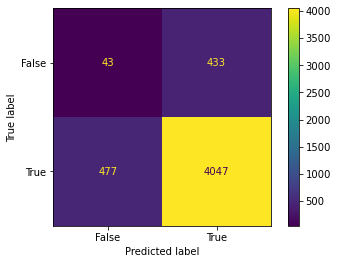

In [20]:
cm_display.plot()
plt.show()

782/782 [==============================] - 5s 6ms/step


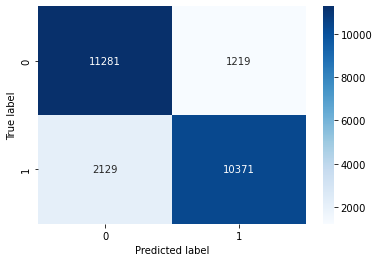

In [21]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# predict probabilities for the test set
y_pred_prob = model.predict(X_test)

# convert probabilities to binary predictions
y_pred = (y_pred_prob > 0.5).astype(int)

# calculate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# plot confusion matrix as heatmap
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.show()


--------------------------------------------------------------------------------------------------------------------------------

In [23]:
import numpy as np
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.datasets import imdb
from tensorflow.keras.preprocessing import sequence

# Load the IMDB dataset and tokenize the words
top_words = 5000
(X_train, y_train), (X_test, y_test) = imdb.load_data(num_words=top_words)

# Load the word index from the dataset
word_index = imdb.get_word_index()

# Reverse the word index
reverse_word_index = dict((index, word) for (word, index) in word_index.items())

# Get user input
user_input = input("Enter a review: ")

# Convert the user input to sequence of integers
user_input_sequence = [word_index.get(word, 0) for word in user_input.lower().split()]

# Tokenize the words in the dataset
tokenizer = Tokenizer(num_words=top_words)
tokenizer.fit_on_texts([user_input])

# Preprocess the user input
user_input_sequence = tokenizer.texts_to_sequences([user_input])

# Define the maximum length of the input sequence (same as during training)
max_words = 500
user_input_padded = sequence.pad_sequences(user_input_sequence, maxlen=max_words)

# Make predictions
prediction = model.predict(np.array(user_input_padded))

# Classify the prediction
if prediction > 0.5:
    sentiment = 'positive'
else:
    sentiment = 'negative'

print("Predicted sentiment: ", sentiment)


Enter a review: good movie
1/1 [==============================] - 0s 30ms/step
Predicted sentiment:  negative


In [19]:
from tensorflow.keras.datasets import imdb

# Load the IMDB dataset
(X_train, y_train), (X_test, y_test) = imdb.load_data(num_words=top_words)

# Load the word index from the dataset
word_index = imdb.get_word_index()

# Reverse the word index to map integers to words
reverse_word_index = {index: word for word, index in word_index.items()}

# Convert the integer sequences to text reviews
def integer_sequence_to_text(sequence):
    words = [reverse_word_index.get(index - 3, '?') for index in sequence]
    return ' '.join(words)

# Print the complete training dataset
for i, (sequence, label) in enumerate(zip(X_train, y_train)):
    review = integer_sequence_to_text(sequence)
    print("Review", i+1, "Label:", label)
    print("Review text:", review)
    print()




Review 1 Label: 1
Review text: ? this film was just brilliant casting location scenery story direction everyone's really suited the part they played and you could just imagine being there robert ? is an amazing actor and now the same being director ? father came from the same scottish island as myself so i loved the fact there was a real connection with this film the witty remarks throughout the film were great it was just brilliant so much that i bought the film as soon as it was released for ? and would recommend it to everyone to watch and the fly ? was amazing really cried at the end it was so sad and you know what they say if you cry at a film it must have been good and this definitely was also ? to the two little ? that played the ? of norman and paul they were just brilliant children are often left out of the ? list i think because the stars that play them all grown up are such a big ? for the whole film but these children are amazing and should be ? for what they have done don'

Review 165 Label: 0
Review text: ? this film was so disappointing from the ? that made me decide to see phantom love why is it called this i had expected something ? and thoughtful with beautiful imagery it did have some interesting images but these often seemed random and made no sense in fact they seemed like they were ? to fill in time in the end the effect was ? br br i believe the film was meant to be atmospheric but it just wasn't the lack of a coherent plot did not help matters you might say it was mysterious but i think it was just incoherent with no atmosphere br br the main character seemed to be disturbed but the plot did not draw me in enough to care about her situation without looking at the cast list i would not have known that you see the main character as a child the film has very little context for the time place or character i am not a ? but the sex scenes there were several seemed pointless and confused me further i ? ? but i was not sure if it was the same man diffe

Review 347 Label: 1
Review text: ? i rented this movie on dvd without knowing what to expect and as i am about to study film making in canada of all places i most certainly will bring this up in class br br the story centered around the probably most ? film team in the history of film itself is brilliantly written and the very talented actors manage to deliver every single ? on time br br if you simply couldn't laugh during hollywood north i suggest seeing a psychiatrist right away you might have serious issues br br besides the wonderful script i also noticed the great chemistry between actors ? ? ? and matthew ? where they really just acting jennifer ? playing a hilariously bad actress and martin ? also delivered a very ? yet funny performance br br great film even better cast

Review 348 Label: 1
Review text: ? while the british produced some hilarious and slick ? in the ? ? ? men ? badly one foot in the grave etc the 70s were the real golden age br br in the 1970s there were whole 

Review text: ? kim ? a witch on the ? for a ? lover and james ? her choice ? comedy of ? from the broadway stage shot by james ? ? in witch color and performed by a ? cast ? ? is wonderful as the ? ? writer ? i love this movie though few others seem to kim alone makes it a winner in my book ha my 5 film of ?

Review 472 Label: 1
Review text: ? this is a cute little horror spoof comedy featuring ? ? aka elvira mistress of the dark the most infamous horror ? of all time this was meant to be the pilot vehicle for elvira and was so successful that it was picked up by the ? network they filmed a pilot for a television series to feature the ? babe in black but unfortunately the sit com never made it past the pilot stage due to it's sexual references this film however is very amusing elvira is the modern day ? morgan and the queen of the one liners this film was followed up a few years later by the abysmal ? haunted hills which was meant to be a take off of the old roger ? movies but falls fl

Review text: ? i really wanted to like the ? book intriguing story interesting character ? ? ? in the utterly glorious altogether unfortunately i hated every minute of it ? got so ? with ? the movie ? and not to the film's benefit i won't even get into ? ? abysmal acting br br you get ? from the story with 4 ? ? ? and ? that ? on the bottom of the screen ? the lyrics of the music that's playing it seems he lost sight of ? the actual story and developing the plot and got ? with ? ? ? that have nothing to do with anything it's a bit like ? a john singer ? portrait in a ? ? frame that says ? loves me in big ? letters br br this movie seems to be a ? of the director ? ego instead of what it could have been ? and ? beautiful in another director's hands ? ? it could have been a masterpiece in ? hands it's best ? to fine arts classes that also take themselves too seriously

Review 703 Label: 1
Review text: ? i think that this movie is very fun and horror i love elvira and i like this movie it


Review 826 Label: 0
Review text: ? ? was part of the video nasty ? film ? that the uk built up in the 80's keeps the gory stuff out of the hands of children don't you know it must have left many wondering what the ? was all about by today's standard ? is a tame little fairy tale br br 3 girls are off to a jazz concert and right away you know the body count is going to be quite low they get lost in the woods wind up getting in a car accident that looks so fake it's laughable they are picked up by some nearby ? that live in the woods in a creepy house one of the girls is seriously ? and has to stay ? then there's talking talking about why the girls are here and how they must be to dinner on time because mother doesn't like it when someone is late and more talking ? ? some suspense is built as a crazy guy is walking around and ? the girls and someone's ? is looking through holes in the walls at the pretty girls in something that looks like ? psycho i ? because there is so much blah blah 

Review 1030 Label: 1
Review text: ? adorable i saw domestic ? in ? in ? with my kids we all liked it so much that we saw it a second time with my parents i haven't heard them laugh like that in years it was the first time that i can remember seeing a movie that my parents and my kids could enjoy it's really cute and we can't wait for it to come out on dvd they need to make more movies like domestic ? it is refreshing to go to a movie that three different ? can enjoy and not be embarrassed i have not seen a movie this cute since my big fat greek wedding i loved ? ? as the mother she was also in ? powers howard ? is in this too and he is hilarious i remember him from ?

Review 1031 Label: 1
Review text: ? starting off here's a synopsis porno queen ? lee ? ? is murdered by her ? lover max george ? in a game of sexual russian ? ? other lover ? lesbian casting agent ? stone mary ? provides an ? for max but ? has an ? of her own and a plan involving the ? of innocent actress julie ? again in

Review text: ? i ? grand ? earlier this year when i set out to ? a ten best list of the ? i first saw the film when i was 17 years old how did i hear about it it was ? and recommended highly by ? ? in ? and i eventually caught it on video a year later br br it's a great film a powerful film a ? film about the power of listening truly listening to one another i've seen it six times now and it ? and ? me with every subsequent viewing but why the poor reviews for this movie ? movie guide gives it two out of four too melodramatic too much ? too sappy are the expressions that i read the most yes there is melodrama in this story and yes there is a lot of ? too but it delivers with an intensity and force that seems ? for all of the plot that exists in grand ? such as drive by ? a police chase an ? a love affair a woman's discovery of a baby in the ? another shooting a near accident by a new driver and ? advice from a homeless man this movie wins because of the smart performances by kevin ? st

Review text: ? i watched ? ? the movie theater and i liked the movie spite of the fact that ? ? many flaws and scientific errors like humans ? dinosaurs and ? living at the same period and even the location of where the story passes looks north america but has some ? from ? for example we can have fun even so unless you are very severe br br the planet is ? an ice age and many animals are ? to the south where is ? ? is a stupid ? that is left behind by his own family that can't stand him any longer walking in his way he meets ? or how he calls ? ? a moody ? who does not care about ? or ? and is going to the north worried that he can easily be captured ? decides to follow ? and in the middle of their journey they found a human mother with her baby the mother dies but ? and ? decides to take him and return the baby for the humans ? one of the ? decides to follow and help them to go to a ? to the ? camp what ? and ? does not know is that ? is from a ? ? who hates humans and wants to kill 

Review text: ? i've found the movie offensive for americans which lost somebody in the ? for american people in general pretending to be an homage to horrible facts happened last years each director takes the opportunity to ? with old facts which have none to do with a terrorist attack or ? ? political ? or compare different political situation as they have in own country having this nothing to do or to share with the ? of september 11 shame on them

Review 1586 Label: 0
Review text: ? robin williams gave a fine performance in the night ? as did the other cast members however the movie seems rushed and leaves too many loose ends to be considered a must see i think the problem happens because there isn't a strong enough relationship established between the ? and the gabriel ? i had to spell it this way because imdb wants to ? correct the right ? to no one character the movie runs a little over ? 30 and within the first 15 minutes or so it seems ? begins his search for ? ? the boy ? br b


Review 1822 Label: 1
Review text: ? this film is a true and historical film it is very useful to those ? the ? church because it is 100 true it is an excellent film and i recommend it br br it is very ? exciting and ? there are some who think it is not ? but it is br br it is about the ? of the church of jesus christ of latter day ? and about the ? joseph smith who restored it it has such events in his life as the disease that he had when he was a small boy his ? emma smith emma his wife giving birth and so on but most importantly it reveals the ? of the church

Review 1823 Label: 0
Review text: ? here be spoilers br br ? ? ? is returning home from capital ? to rural ? to ? her ? ? birthday she is by far the ? child and has two sisters ? ? and ? ? ? has a family and still lives in ? and ? has ? and moved a town away ? is still single and is focused on her career there are a lot of ? and almost ? between the sisters and conflicts ? all around as they ? each other and each have personal

Review text: ? this is definitely one of the best kung fu movies ever and may be one of the best movies ever it's got a great plot that ? like a ? with lots of intrigue and suspense this film is full of cat and mouse games and ? with people hiding their ? and their ? the characters in this film live and breath much more than your average kung fu movie characters they are all interesting and compelling and the movie does a good job at giving them scenes to show their ? and ? br br the fight scenes play out like little stories and many of them are very original and exciting it has cool training sequences and martial arts skills that are so awesome they enter the ? of fantasy there are 5 members of the ? ? each one with his own style that ? the special skill of a ? animal the styles of each of these characters are fun to watch and you can see the techniques they use in training ? during the film when this happens the director uses quick cutting back to the training scene to draw a paralle

Review 2217 Label: 0
Review text: ? three russian ? ? up the ? of ? ? despite the fact they are down to their last ? in order to support their ? lifestyle the three use the ? of a ? and use the notes at the ? hoping to ? the ? ? for a ? andrew ? a us ? arrives at ? with his wife helen and the three decide to make ? with the ? hoping for financial ? one of the three ? count ? ? plans to go further with ? advance towards helen while disappointing the ? ? who loves ? eventually circumstances play their hand against the three ? its obvious that von ? was trying to convey a message with the ? of american women and the ? ? of the ? rather than tell a story and the film really can bore modern audiences like me easily by doing that even the acting which is great in later ? like greed and the wedding march is just run of the mill here the film could have used ? on various levels rating 3

Review 2218 Label: 0
Review text: ? you already know how painful to watch this movie is but i wonder why on

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Review 3471 Label: 0
Review text: ? ? of the ? is a film ? in flop ? i can recall no film that has tried so hard to be so ? outrageous ? and important yet failed so consistently across the board it is like a stand up comic who's not getting laughs but can't leave the stage the harder the film tries the ? each attempt at a laugh results in a ? ? the desperation the film displays is so ? it almost ? pity for all those involved br br the film ? laugh out loud status only twice once is in the sight of ? ? playing an obnoxious arrogant and ? tv ? journalist which is funny only because he apparently doesn't realize he is playing himself the other scene that deserves to be laughed at is the film's final big moment ? the judge played by morgan freeman delivers the ? ? about what morality is it's what your ? taught ya the ? of the moment is insulting to the point of being absurd br br yet one must admit it is a noble effort it does have a good if poorly cast band of actors who try to make char

Review text: ? when i was little my parents took me along to the theater to see ? it was one of many movies i watched with my parents but this was the only one we walked out of since then i had never seen ? until just recently and i could have lived out the rest of my life without it what a pretentious ? and painfully boring piece of 70's ? and cheese ? woody allen is one of my favorite directors but ? is by far the worst piece of crap of his career in the ? style of ? ? allen gives us a dark ? ? insight in to the lives of a family ? by the psychological damage caused by divorce ? career love non love ? whatever the film intentionally has no comic relief no music and is ? in ? ? this film style can be best defined as ? in nature using an ? method of dialogue to ? a more ? depth of meaning and truth but woody allen is no ? ? the film is painfully slow and dull but beyond that i simply had no connection with or sympathy for any of the characters instead i felt only ? for this ? of ? ? ? 

Review text: ? average and surprisingly tame fulci giallo which means it's still quite bad by normal standards but ? by its solid build up and some nice touches such as a neat time twist on the issues of ? and ? br br the ? well known ? are in full ? ? dialogue wooden acting illogical plot points and the finale goes on much too long while the ? proves to be a rather lame or shall i say ? affair br br ? ironic ? of giallo ? is amusing though yellow clues ? you look br br 3 out of 10 ? killers

Review 3777 Label: 0
Review text: ? i thought this was a sequel of some sorts and it is meant to be to the original from 1983 but a sequel is not taking the original plot and destroying it br br i actually had very little expectations to this movie but i just wasted ? minutes of life no suspense i actually feel ? poor acting and so filled with technical errors so i as a computer ? just couldn't believe it they have tried to make it a mix between a generic war movie and 24 hours but this is not eve

Review 4012 Label: 1
Review text: ? i just can't believe some of the comments on this show the show is just genius sure it doesn't follow the tried and true but do we as ? always want the same things ? at us over and over again shouldn't we have the ? to sit back and enjoy something new once in a while the style is not as realistic as previous scooby doo shows but it's not supposed to be the show it titled ? and scooby doo get a clue what part of that title states that the entire beloved cast of other ? would constantly join in the action and nowhere does it say that they'd be ? mysteries and they can't even stand monsters so why would they i'm actually glad that they put some long standing plot points that work into a scooby doo show they still have running jokes clumsy ? ? quick change ? in chase scenes the standard ? gag and even scooby ? in fact i'm glad that this show is out there because i just love it i'm even glad they got rid of the rest of the team for a while and ? on just t

Review 4215 Label: 1
Review text: ? titanic has to be one of my all time favorite movies it has its problems what movies don't but still it's enjoyable br br when i ? across someone who asks me why i like titanic i suppose my first reaction is wait a minute you don't i know so many people who don't like this movie and i'm not saying i don't see why the love story is too cheesy well yes but isn't it enjoyable and moving all right the love story between jack and rose is very unrealistic everyone knows that love like this doesn't actually exist but this is a movie doesn't everyone enjoy watching a beautiful story that lets us ? slightly into fantasy for a while the next complaint ? and ? are terrible actors well ok in this movie i agree that they do not perform to their full ? however i think it's ? to say that they are terrible actors i personally think they are both very talented actors who unfortunately are very famous for a movie that they are not amazing in but the roles they are giv

Review text: ? the last station director michael ? melodrama about the last months in the life of leo ? begins with ? and sleep ? christopher ? lives with his family in a ? at ? ? taking walks and writing and being seen to by his wife and the ? to his movement people dedicated to his ideas of ? ? sexual ? and ? property who have ? in a forest camp not far away his wife ? helen ? wars ? with the head of his movement ? paul ? who she claims in his efforts to convince ? to sign the rights to his works over to the russian people is trying to steal the wealth that is ? to her upon her ? ? death ? all of this is ? new ? ? james ? a naive ? who is torn between his love of the man and concern for his wife br br ? script which is based on the novel by jay ? quite often ? itself into confused territory building up a complex ? of ? and ? motivations that ultimately don't ? themselves in any satisfying way the scope of the film is grand and its story should ? just as ? whose beliefs ? in some ways

Review 4624 Label: 1
Review text: ? ? cat the ? of these cartoons is a good one at least i like it so i'm surprised that this is getting mixed reviews br br this one is more of a ? story than a funny one although it has its moments of comedy the atmosphere is dark and spooky suspense is another strong element here as for humor it's mostly dark humor br br in this short tom ? to a creepy radio show at night and is absolutely ? because it is about ghosts something he believes while tom is scared to death jerry is watching everything and can't help but laugh the whole time in fact jerry quickly finds a way to torture him more and more with the help of a white shirt and a ? ? he creates a big ghost br br tom lives the ? experience of his whole life although jerry scares tom without a good reason the way the story is made ends up being funny plus once again there is no violence here because this is one of tom ? ? cartoons however i don't get that joke of ? 9 lives nearly sucked into the ? ?

Review 4821 Label: 1
Review text: ? british comedies tend to fall into one of two main types the quiet ? usually romantic study and the ? social satire settings characters and ? ? but certain ? place the vast majority of shows into one of the two ? ? is perhaps the ? of the first type br br the scripts are very ? including long ? ? by the main character ? a basically happy but ? ? curious about what she might have missed out on when she ? on a thoroughly conventional life when she meets a successful but clumsy and emotionally ? ? who makes his interest in her quite clear she toys with the idea of finding out what the other path might have offered br br the acting and scripts are always on the money which makes one's reaction to the show almost entirely a personal one i was neither blown away by it nor turned off my mother on the other hand ? this show i think the degree to which one ? with ? ? is the most important factor in ? one's reaction to ?

Review 4822 Label: 0
Review text: ? it


Review 5018 Label: 1
Review text: ? this has got to be a unique twists of two genres of ever seen the giant monster movie genre with the living mummy movie genre this unique blend makes for a unique and compelling story the ? is outstanding including tom ? who as far as i know never has been in a horror movie before ever the effects are impressive and the idea of a giant mummy filled with smaller ? is a cool one my one complaint i just wish we saw more of the giant mummy but other then that i think they did a great job the dialog the characters and the story was perfect the acting was wonderful this has got to be the best movie to come out of the sci fi channel you heard me the best movie to come out of the sci fi channel i give the fallen ones 9 out of 10

Review 5019 Label: 1
Review text: ? the ghost train is a treat to those who appreciate the typical ? humour it ? world war two into the plot but not as much as i initially believed it would and the characters are a unique blend who

Review 5220 Label: 1
Review text: ? this movie is very great the acting is fine with excellent casting of ? ? as the ? dentist who ? out and ? his patients in the beginning he sees his wife with the ? and then he goes crazy he also takes revenge on his wife and the ? ? the patients he ? the most special effects are also beautiful although some are really fake like a ? out tongue that has laid for 1 night outside and is still red in the morning but the torture scenes are absolutely well done though this movie has the weak point that it is very slow between the heavy parts are sometimes just ? boring parts but for the real horror thriller fan this is a must watch

Review 5221 Label: 1
Review text: ? carol the young girl at the center of the story is ? to a foreign land ? at the ? of the civil war conflict in the late ? for this girl everything is new in it's ? the war and her father are her constant ? while she has to ? herself in a ? culture that is years behind what she has in new york


Review 5347 Label: 1
Review text: ? will smith is one of the best actors of all time i don't know how he does it i read books constantly but if there is a movie with will smith i will watch it he has a rare gift of pulling you into the movie and holding you there this movie is one of the best movies i have seen yet i watched it on saturday and i still cannot get it out of my head amazing and sad all at the same time thanks again will you must watch this movie from beginning to end to understand every part of the movie you cannot miss a thing make sure you have plenty of ? and your man woman sitting next to you so you can ? well worth the money that you will pay to watch it don't wait for it to come on tv

Review 5348 Label: 0
Review text: ? a ? returns from mars about a couple of months earlier a 4 person ? had been sent to the red planet most of the picture is a flashback to what ? over there the picture is ? by inane melodramatic dialog typical of many sci fi efforts of the ? sixtie

Review 5541 Label: 0
Review text: ? it's not like i have ? fond memories of ? original pants down ? it always struck me as a ? well made airport novel of a movie thrilling sexy trash but trash nonetheless it was also a film that ? into a certain sexual ? after a decade of anti sex aids ? ? a film about a ? sexual ? who thrill kills to ? her sexual pleasure was pretty ? stuff basic instinct 2 was always going to struggle to provide the same social ? and ? so the fact that it's desperate attempts at ? are so lame can sort of be overlooked all it really had to provide was that thin ? of ? and a mildly engaging story and all would have been watchable that it ? fails on so many levels and in such a way to be a career ? for everyone involved is really quite extraordinary to watch let's state the obvious for ? ? stone is too old for the part of sexual ? catherine ? what was so ? thru ? ? looks like ? dressed as ? in the hands of gun for hire michael ? jones who's flat ? ? and ? camera ? her ?

Review text: ? although there's flying ? as part of the title of this movie it has no ? to the original flying ? ? and its sequel flying ? ii ? the two ? are masterpieces of kung fu movie and still stands out as a classic this is a much inferior copy of the original and even as a regular kung fu movie it's below average br br first of all this movie doesn't have much acting it's one senseless fight scene after another and flying ? doesn't even play a major part in them story is about some ? ? who are ? down some villains ? took off with a ? book and an evil prince who ? part of this book is part of the plot the same evil prince has plans to ? the ? in and use the flying ? on them br br there are four movies with flying ? as part of its title this in my opinion is of least quality the design of the flying ? in this movie is different from the other three ? that this movie was produced by a different ? from the other three br br the movie has no chemistry ? from being unintentionally fun

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Review 6940 Label: 0
Review text: ? since this is part 2 then ? it to part one br br man that was on many places ? too many time jumps etc br br i have to say that i was really ? br br only ? little lame action and thats it br br they could have done that better br br

Review 6941 Label: 0
Review text: ? knowing how old a film is ought to ? the viewer for a few things and with those things in mind perhaps the ? be more ? so it was when i watched ? of the zombies the heavy ? on tedious dialogue and corny movements should be expected as should the ? or absence of special effects in those days a great deal is asked from the imagination of the ? maybe too much in this case and the plot isn't easy to follow some ? ? asian soldiers in ? performed very ? although ? as to why if true the explanation should stay out of the wrong hands so off goes a group to ? investigate the key to long distance ? is learned by a member of the ? who uses it to among other purposes ? ? with the ? of the ? for w

Review 7099 Label: 0
Review text: ? woody allen has made some of the greatest comedies ever and i would seriously consider saying that annie hall is the greatest movie ever but if i really think about it i will probably think of one or two that are better but it would be hard he has had of course some films that aren't quite good but not that bad either like manhattan murder mystery and sweet and ? but he has never before had a film quite as bad as ? and ? not quite so tired and so unfunny his films are usually witty and hilarious but how did this happen is it still our good old woody the plot runs around four friends who are having dinner together two are play writers and one of the others mentions a funny story that happened to a friend of ? it is about a young woman who ? in on a dinner party unexpected we never hear the rest because the two play writes start to ? whether it would make a better comedy or tragedy than we begin to see the two points of view both center on this woman n


Review 7306 Label: 1
Review text: ? includes spoilers br br i've been a horror film fan now for many decades just when i think i've seen all the great ones another pops up to surprise me i had never seen this film before it was a treat off the beaten path too not just the path to the ? ? boat either here was a horror film made in the ? that ? to try something very different the pretty girl is ? ? for a change and saves the men including the man she loves from the monster how is that for a twist this girl was the complete opposite of most women in films of that time no screaming at her own shadow no ? from ? no ? over a ? as she runs this ? wasn't afraid to live alone in a ? ? far away from the rest of the ? not only that but the place was on a ? ? ? to be haunted heck she even takes ? on the ? ? ? like a regular ? version of ? no snake ? or ? ? would dare bother this ? books on early feminist films should be sure to include this overlooked work br br see this if you are a fan like me 

Review 7546 Label: 1
Review text: ? a masterpiece of comedy a masterpiece of horror a masterpiece of romance if there is anything negative to say about a chinese ghost story it might be that the special effects looked dated in comparison to modern technology the film has a simple premise a poor ? ? has to stay in a ? area while trying to ? a ? of course it happens to be haunted as well br br what i wasn't expecting the first time i saw this film is that it's one of the most touching love stories i've ever seen that is without losing any of the slapstick comedy that will have you in ? unlike some films of asian cinema a chinese ghost story isn't hard to ? for those that aren't ? in chinese culture indeed it plays on timeless ? themes of the ? and romance br br think evil dead 2 if they had thrown a wonderful love story into the mix this film is for real despite being overlooked by many it's absolutely among the best i've ever seen it's ability to combine the best aspects of multiple gen

Review 7722 Label: 1
Review text: ? i have to agree with most of the other ? was it a comedy a drama to me it ? a little to much towards the comedy side i could have been a great movie without the comedy and it was horribly contrived jamie keeps running into the ? and whats his name in new york how many times do you run into someone you know in ? ? and just how could robert ? dig up ? ? to hide the gold again a comedy or drama but it was still entertaining especially for a sunday morning i enjoyed ? ? performance she certainly a beautiful actress and seems to take her craft seriously she is a younger actress that is going to be ?

Review 7723 Label: 1
Review text: ? despite its rather ? title this is a light teen ? unless you're an old ? you'll probably find it ? it isn't so good on developing characters or situations ? though when you view it you get the feeling that you've been running back and forth to the kitchen even if you've been sitting down watching the whole time this is one 

Review text: ? definitely at the top five of best john ? movies has to be pride of the ? it's the true story of ? private al ? who at the cost of his own sight while wounded held off a ? of ? japanese on ? br br the story nicely segments in three parts al ? home life where he's a simple working stiff who's just getting serious with a woman and who likes nothing better than his ? night pearl ? is ? and he's off to war as millions of others were br br the second part is at ? and we see part of the action where he's in an isolated machine gun ? holding off japanese troops his action ? ? ? from being ? but a ? does in his ? br br and of course the third part is his painful ? to ? life and to ? himself that people aren't just caring for him out of pity most of all that girl he was seeing ? parker br br this film was broadcast on ? on john ? ? birthday and there was a documentary on ? ? by his daughter one of the people ? said that ? was the actor most believable in working class roles in ha


Review 8094 Label: 1
Review text: ? sure for it's super imagery and awesome sound it's a great home theater show off ? but this is also a touching drama as well as an ? documentary the parallel stories that are ? throughout this film will keep all viewers interested young old boys and girls alike will find that deep down we are all fans of the ? especially the high performance ? machines that are the result of ? blood ? tears ? and ? the mark ? and ? ? sound track is perfectly matched to the visuals and the content i don't want to give away the ending but the final driving sequence to ? ? days like these just might bring a tear to your eye enjoy it

Review 8095 Label: 1
Review text: ? one word can describe this movie and that is weird i recorded this movie one day because it was a japanese animation and it was old so i thought it would be interesting well it was the movie is about a young boy who travels the universe to get a metal body so he can seek revenge on the way he meets very 

Review 8241 Label: 1
Review text: ? he's ? ? slightly cross eyed and ? he stands in front of us and calls himself a ? he claims that we  the film viewers  ? the screen as a toilet ? and are all secretly wishing for all the s t to ? from the inside he's ? and scary ? come on you could have guessed by now he's one of the leading ? of our age br br ? ? is both a narrator and a subject of ? ? extraordinary new film a ? guide to the cinema ? ? a feature long ? by ? and does so in two ways by providing ? film clips and putting ? on real or ? locations from the movies he speaks about it's always nice to watch ? ? scenes from great movies although revenge of the ? got here as well but the main attraction of a ? ? is ? himself what makes the movie such fun to watch is the ? question one cannot help but ask over and over again what is more outrageous ? views or ? screen presence in a documentary by ? taylor ? ? ? ? at one point ? his fear of being silent because he claimed he feels like he doe

Review text: ? generally i don't like films directed by ? ? the ? being somewhat of an exception and i've never been a robert ? fan either still i thought three days of the ? must be good because of the number of ? comments it has received br br although the ? cinematography is quite ? for the eye and max von ? does a nice job as the sinister professional killer i found the whole affair ? disappointing the film ? ? ? atmosphere but everything is ruined by the ? plot which doesn't seem to make any sense br br the film also contains one of the most ? endings i have ever seen which really leaves the viewer hanging in the air and what can one say about that absurd romance between ? and ? i'd much rather watch any of ? films five times in ? than to sit through this piece of waste once more

Review 8410 Label: 0
Review text: ? this has an interesting albeit somewhat ? sci fi plot but it's wasted with poor direction and ? special effects ? dawn ? is appealing despite the lack of a believable 

Review 8609 Label: 1
Review text: ? cute idea ? linda smith ? ? ? a ? tiny little ? of ? that country which wasn't even in north america was made the ? state of course there were only ? states at the time since this was made in ? linda travels to the country she has ? and we follow her along as she tries to figure out what to do with this strange country and its even ? people at one point she sings a song that she claims is from her people the ? and it gets ever more ? from there although ? ? heavy ? and ? present smile never get ? or ? there are other songs ? through out as the ? sing to welcome their new princess filmed in a glorious british version of ? or some such equivalent about the only big name here is ? ? as british subject tony craig cheese ? ? made a big ? in the uk film industry after serving in the war and was even ? by ? ii craig and the new princess keep ? into each other and their adventures become more ? as ? financial problems ? fun little farce along the lines of ? 

Review 8853 Label: 1
Review text: ? this has just been broadcast on bbc and i am absolutely ? to have seen it as the credits rolled the cast alone made certain that i would give it a go after just five minutes i was completely ? in this beautiful film br br yes it was formulaic and predictable but that somehow added to it's charm the flashbacks to the ? were wonderfully placed and captured a feeling ? in few productions br br a real feel good film ? throughout with outstanding music when it's released i'll buy it

Review 8854 Label: 1
Review text: ? i loved this movie and will watch it again original twist to plot of man vs man vs self i think this is kurt ? best movie his eyes ? more than most actors words perhaps there's hope for ? in spite of government ?

Review 8855 Label: 1
Review text: ? if you enjoy ? all the british ? humour of the time then this little gem is absolutely hilarious br br arthur ? is a real treat br br i saw this with friends on tv when it first came out and its

Review 9005 Label: 0
Review text: ? any film which begins with a ? ? a female ? can't promise much as for the ? of the ? as it was 50 ? ago well i was there and it just wasn't like that ok every ? had just a small piece of something shown in the film like ? ? the kitchen at night but you can't show the whole ? as being full of all those shall we say ? ? each ? had its own problems but hardly any ? had all of them the views of israel were great i still remember my youth in that garden of ? called the ? ? yes and the acting was good too so you see it wasn't all black just a wrong portrayal probably on purpose too

Review 9006 Label: 1
Review text: ? i didn't even want to watch this movie after reading ? review and 1 1 2 star rating i watched it anyway on the advice of my son and found it much better than i expected i would give it 2 1 2 stars out of a 4 star system you have to watch the movie more than once to understand it all if you don't know much about religion you will miss a lot i 


Review 9203 Label: 1
Review text: ? dick tracy was originally a comic book created in ? by ? ? he is a ? detective who tracks down a crew of villains ? from all types of visually original characters such as ? to the blank to big boy ? these villains became so popular in the ? that warner ? created their own take on the tracy style villains in such cartoons as ? ? ? comics were known for their liberal use of ? and the up to date technology ? notably the ? ? which got their fair share of screen time on this excellent movie the music was done wonderfully by danny ? and the original songs by madonna were interesting but they were not the high point for her career it's weird because as you watch the film and see the suspenseful moments the film feels so much like batman because of ? memorable sound to his pieces br br i love the tough talking kid ? acting as big boy ? and that ? ? take on ? and the cinematography and directing were ? this film was very ? made and features tons of great act

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Review 10191 Label: 1
Review text: ? the whole does not even come close to the sum of the parts no problem this film features a line up of some of the most ? creative directors of our time and some really famous names in the cast the segments are ? around the same theme love in paris but the resemblance ends there actually considering that the approach to the theme from all these different directors takes so many forms it is amazing that we can even feel we are still watching the same film no great effort has been made to turn it into a ? whole this ? has so many great ingredients i am glad nobody tried to put them all in a single ?

Review 10192 Label: 1
Review text: ? one of the most important artistic movements in the history of cinema was without a doubt german ? the highly atmospheric style of film making developed during the ? in berlin classic movies like ? ? ? dr ? ? and ? ? ? ? ? ? were the most famous direct results of this movement and while the movement didn't have a long l

Review text: ? if you enjoy the original snl cast and shows then avoid this movie at all costs when this first came out my friends and i waited in line for over an hour to get in to a sold out movie house half way through the movie the theatre was 3 4 empty we ? to leave thinking it would get better when the movie ended we were the only ones left in the theatre the movie lasted only one day in all theaters then ? from sight in interviews with mr mike he ? to comment on this film the film was an inside joke on the episodes of snl that came out right after the films release and closing in one day we all tried to contact mr mike by phone and mail to get a ? but were totally ignored

Review 10363 Label: 0
Review text: ? in ? mine workers find the ? of an ancient ? civilization named ? that believe there are the worlds of light and darkness when they opened the ? between these worlds ten thousand years ago something evil ? through before the ? was closed twenty two years ago the government 

Review text: ? this is without a doubt the greatest film ever made it is nearly incomprehensible even with many repeated viewings in an attempt to figure out what ? going on the film was almost entirely ? and includes random musical numbers commercials ? one enters by mail and a host of other ? besides what other movies have cameos by martin ? king jr to ? the film hunt down the director's book ? i was curious it'll all become clear it's a grand and bold experiment in ? ? ? a triumph now if only someone would put out a version with the subtitles in a color other than white the white subtitles tend to ? out and become invisible

Review 10536 Label: 1
Review text: ? ? ? is laughing while ? in his easy chair and reading his comic book his dog ? nearby sleeping in front of the ? all is ? until a ? comes ? by the ? is dressed in a ? type outfit with a big ? and is carrying a ? with the name a ? on it he gets out his ? and spots the dog we see a big shot of the ? butt and the ? ? in exciteme

Review 10745 Label: 1
Review text: ? i took my ? year old daughter with me to see this interesting exercise in movie making i always find it intriguing to get views and opinions from a different generation on movies especially as i'm such a ? myself it's good to get an ? opinion from someone who hasn't yet reached the been there done that approach to every movie she sees i'm pleased to say that we both really enjoyed it and ? it as a successful mother daughter evening out far far better than going to see some brain dead chick flick which i ? is what we are supposed to enjoy according to the ? br br ? directors were asked to produce a short piece about each of the ? of paris a city i haven't ? in 20 years but i wish i had they are loosely ? by ? shots and represent different ? to love in the city ? in popular culture as the ? romantic capital of the world some of the films work better than others but as other reviewers have said it never ? too far into ? some are funny some are sad some

Review 10978 Label: 1
Review text: ? i found this movie hilarious the ? on other popular movies of that time were some of the funniest i have seen in this sort of movie give it a try if you saw the movies that this movie is ? and you get the humor you should enjoy the movie br br i and the others who watched the movie with me felt the funniest part in the movie this is not a spoiler because i will not tell you what actually happens was a scene with the ? ? from ? when they first discover the device and do not know what it is does and then again later in the movie you'll understand when you get there br br my only complaint about the movie is that i have never been able to find it in dvd so that i could buy a copy

Review 10979 Label: 0
Review text: ? i don't know about you but what i love about tom and jerry cartoons is the often violent interaction between the two characters mouse in manhattan sees jerry leaving tom behind to have an adventure in new york and as far as i am concerned 

Review 11160 Label: 0
Review text: ? wow i just finally managed after several attempts to finish watching this god awful movie only to learn that rick ? and his production team have ? a straight to video sequel this year br br of all movies ? by mst3k and they truly dig from the bottom of the ? screening the ? bad ? ' ? ' 'the incredibly strange ' and the lesser know ? like ? ' ? nightmare ' and ? ? ' this certainly has to be the absolute biggest pile of garbage they'd ever shown which makes it perfect for ? very simple the movie is about a bunch of ? like ? on the loose ? people's ? for fame fortune ? and of course sex in ways that end up with people getting killed but this is the kind of movie where the acting is so ridiculous a test of ? for example is ? by two guys who battle in the front ? with garden ? the writing is so forced such as the ? described scene of a ? hanging on the arm of one girl who would notice it if only she turned her head a ? to the left and this isn't the firs

Review 11338 Label: 1
Review text: ? i ? across this act i by pure dumb luck and this was more than a decade ago this ? even what the cover ? on the tape mentioned it amazed me it ? me it shocked me i eventually forgot about and almost a decade later i happened to think about it again then went and bought both acts they were even better than i had experienced at first br br my only complaint is that while the ? police keep on going on and on about being at war with crime ? ? and heavy ? it would seem as though they are really having a hard time with criminals that is either never shown or is simply a lie as they appear to be taking it easy most of the time if that bit about being in a state of war was really propaganda it certainly has not been shown as such br br i don't think the original japanese version could have been any where as good as the ? version of this but regarding the story there has certainly been some proper ? lost in translation but it can be ?

Review 11339 Label: 1


Review 11544 Label: 1
Review text: ? an incredible little english film for so many reasons first it's a rare look a ? olivier in a light comedy while his performance is not up the standard he would latter set as one of the greatest actors of the 20th century he is perfectly believable as the ? ? historically this film is of great interest because of both where and when it was shoot being english it didn't have the big budget of the hollywood films of the same era and it often shows but more interesting is the fact this movie filmed just prior to the war and shows an england that would soon be gone when we watch it today we think in terms of modern morality and over look the fact that this movie and its closest american counter part it happened one ? were in their day as ? as fatal ? was in our time but after watching and enjoying this movie the first time i can't help but feel sadness when i watch it today with half of film shoot before ? gone saving the remaining films means hard choi

Review text: ? as ? go ? fighting ? is one of the best action ? of the 1930s made in a period when the studios could still field a large cast this one has wall to wall action throughout its 12 ? br br in ? the president of the newly ? ? of mexico ? ? ? young is trying to put his new country on a solid financial ? to that end he has ? to have rich gold ? ? to the ? from the local san ? mine br br members of the local ? plot to steal the ? on ? of don del ? a gold ? god who with the aid of the local ? ? hopes to ? himself as the ? of mexico ? him is don francisco guy ? who forms a ? of ? to aid ? when don ? is murdered by don del ? men a stranger the ? don ? reed ? arrives in town ? aka ? takes over the ? with the help of his friends ? william ? and ? ? ? the ? heroine of the piece is ? sister ? ? ? br br both ? and ? hold ? on the local ? ? it soon becomes apparent that some of the other members of the ? are in league with don del ? first there is the ? of the ? ? de ? the head of the ?


Review 11946 Label: 0
Review text: ? ? ? is a very promising entertainment ? gene kelly and ? ? the team behind an american in paris are ? with a lot of the great ? and women behind their previous ? ? leading lady is ? ? one of the best dancers of ? 50s cinema and unlike the generally superior it's always fair ? this film gave them the chance for not only one but two dances ? and ? were the rising team behind such future hits as my fair lady and ? musical masterpiece ? ? and ? had already ? their ? ? ? on the excellent american in paris br br what happened along the way why is the movie itself such a stupid bore ? himself didn't want to do the movie despite his previous warm artistic and personal relationship with ? maybe it was because the movie's ? ? was just a bit too much of two steps forward for mgm and one step ? for ? ? but once trapped in this ? like the ? of ? are trapped within its city limits ? ? to turn it into something that would be entertaining in a specifically distrac

Review text: ? ok first of all let me say that i'm still amazed of how the plot sucks br br but than again its a movie that sequels a steven ? movie only with no steven ? ? br br just random low budget action scenes really no point i ? still amazed i burned 90 ? on this crap really br br just rent a ? chan movie or go see ? more fun and has no and ? not to have and plot ? ? ? avoid it ? the best actor playing there is bill goldberg and that says a lot br br and no he doesn't play very well like i said ? avoid it ? i still cant believe i wasted 90 ? and spent 10 ? more writing this

Review 12107 Label: 1
Review text: ? bo ? beauty and john ? revolutionary direction make this film worthwhile br br bo looking more gorgeous than ever is a recently ? woman who is ? ? from her ? husband anthony ? he has a plan bo must ? the body of a young man so that her ghost of a husband can make his transformation from ? back to ? life can she find a fitting ? how will she do him in so tony can do his th

Review 12309 Label: 0
Review text: ? when you look back at another bad nightmare sequel like ? revenge you have to at least give it some credit for trying something new and although the dream child is more enjoyable it offers absolutely nothing new to the series yes there's the creative deaths as usual like a kid becoming part of a comic book and facing super freddy but even scenes like that aren't used to their full potential and the parts without freddy are just boring br br this ? the official death of ? to the series freddy seems to be the comedic relief now but to what br br my rating 4 10

Review 12310 Label: 1
Review text: ? what people fail to understand about this movie is that it isn't a beginning middle and end it is just the conclusion of a ? episode long tv series so remember that when you all talk about how the world wasn't explored enough that was all done in the tv show br br as great and stunning as the visuals are i think the spoilers argument between ? ? and ? near t

Review 12544 Label: 0
Review text: ? as you can guess by my rating and my title of this review that i don't like johnny test now i think i know what people are going to say how do you know how bad it is have you ever watched it i did watch this show a couple times because i am ? film and animation and this just doesn't hold a ? to my standards br br i want to first talk about the animation because it is one of the most confusing things i have ever seen like the first two seasons or only first season had hand drawn animation i thought it was a nice show to look at when it was hand drawn but then it ? to flash animation and the quality went down by a huge amount br br so that is one strike in my eyes but lets look at the story of the show it tries way too hard to be like ? lab but there are differences because instead of one red headed scientist there is two and they are both female there is a talking dog why and the parents attitudes are ? somewhat i have others but i don't think i can 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0
Review text: ? after eight ? films the series had run its course as this last entry ? peter ? was clearly ? of trying to ? some sort of human interest and entertainment value into the ? character of ? and the dreadful idea of ? him with a funny british sidekick utterly ? all his efforts here

Review 13761 Label: 0
Review text: ? this movie was exactly what i expected it to be when i first read the casting i probably could have written a more exciting plot it's a pity that they left it to a pack of ? monkeys ? ? was surely a good ? but he has to thank god and we too that he does not have to ? on his actor skills to ? his living he can't play he can't talk he can't even move very good on ? without his ? michelle ? is a pretty blonde girl and that's all she obviously wasn't chosen for her ? ? in dramatic roles but most probably for her nice legs nevertheless i must admit that she could be the ? acting teacher because he's even a worse actor than her and that's funny especially consider

Review text: ? a huge hit upon release with australian audiences it can still be funny today but its over the top political ? and blunt ? humour can make it a bit of a ? it goes on far too long some of br br the content could have been saved for the sequel barry ? holds his own which desperately needed some new stuff anyway granted his ? ? attitude is funny but also becomes annoying as the film drags on some say ? songs are the best bits and they are certainly original but hilarious the adventures of barry ? will go down as a ? in australian cinema but we should do everything in our power to make sure that ? audiences do not see the majority of ? as barry ? or for that matter ? ? rating 5 10

Review 13919 Label: 0
Review text: ? i never actually thought that a film could be so atrocious but alas i was wrong terrible acting terrible plot terrible effects the crocodile was awful and as for the stupid sex killing scene all in one that was a bad move from the word go it was truly shocking 

Review 14152 Label: 1
Review text: ? once upon a time there was a charming land called france people lived happily then the women were easy and the men ? in their favorite ? war the only ? of ? which the people could enjoy the war in question was the seven year's war and when it was noticed that there were more ? of soldiers than soldiers ? were sent out to ? the ranks br br and so it was that ? gerard ? caught ? a ? daughter in a pile of ? escapes marriage by ? in the ? ? but only by first believing his future as ? by a ? that he will win fame and fortune in his ? ? and will marry the king's daughter alas ? ? ? is not a ? but the daughter of the ? ? ? br br when ? ? away from the ? ? in hand to rescue a ? under attack who should be inside but the ? ? ? and the king's daughter he now is convinced he will marry high despite the extremely low cut ? ? wears she in turn will soon discover her own love for ? we're in the middle of an ? movie of ? destiny the ? adventures of a sword fighting

Review text: ? this ? just didn't do it for me while some things such as the battle royal and involvement of ? were a ? to the good old days so to speak it seemed to be more of a ? in your house than anything else above average worth it for several matches such as the tag team title match although worthy of note is that the title change meant nothing as it was ? the next night

Review 14359 Label: 1
Review text: ? i had fun watching red eye it's not a masterpiece but it's well directed and ? ? murphy and rachel ? are perfect in the role yes it's the same old story with a different setting but wes craven gave it a good pace at least not another scream with the usual college killer it's nice when you can see a clean coherent thriller even when originality doesn't stand out as its main character particularly from a film maker like craven that has brought so many innovative ideas to the thriller and horror genre in the past and that now just ? himself to bringing home what could have been 

Review 14561 Label: 0
Review text: ? ? was not my favorite type of movie i found it overly sentimental and the acting was below par harvey ? and ? ? were good but some of the other actors weren't at all believable i also did not believe that ? parents would go away and leave him with the ? family especially when they had a ? living in the home their social classes were too far apart to consider this believable it seemed the ? lifestyle was too exaggerated there was a scene in the beginning of the movie that showed ? ? getting out of a car after having sex with someone who was it her son what was the scene supposed to show us why was the scene even included it had nothing to do with the rest of the movie and was in fact never ? to again it seemed gratuitous and not fitting into the story at all there were too many ? in the movie for me the story concerning ? was nice but i wasn't convinced that the ? would have been as kind and generous as they were portrayed

Review 14562 Label: 1
Revi

Review text: ? for anyone who has seen and fallen in love with the stage musical a chorus line the movie is a ? ? not only are songs cut but unnecessary plot twists added new dance sequences choreographed and let's face it richard ? just doesn't know how to film dancers br br ? michael ? a chorus line was just that michael ? his idea his choreography his direction his gift to broadway and the rest of the world it was two hours of hard hitting in your face realism that really made you feel for these boys and girls the movie however lacks empathy and depth the actors look like they are ? for a chorus line rather than actually ? every move every line of dialogue seems so ? and planned michael douglas especially as ? is too in control for us to believe that he is this ? ? ? even when he throws his ? ? you never quite believe him because every ? every ? word every ? is so obviously ? and as for him not dancing kevin ? ? for the role of ? on broadway michael ? loved his reading but ? couldn'


Review 14938 Label: 1
Review text: ? i'm from ? i'll try to speak in english all i want to say about this movie is that it is and will be my all time number one seen it above 30 times at least and will see it for many years now it has all the little things i like in a movie it's very touching makes me cry shows a whole lot of twisted love things and questions about love and reality and the true things that matter for different people it so happens that for me this matters the most the love the soul of a man he's inner being and this i see in this movie perhaps for me it's much more than a motion picture it's a proof in my mind that it could really exist and that you most make the best out of every moment you live with your soul mate it's a long way from reality to sci fi but what if what if all the ? disappeared and ? would go down would fall we would all be concerned about other issues and my thought is that on your death bed the bigger thing you remember is not the wealth not the ad

Review 15068 Label: 1
Review text: ? was lucky enough to be an extra in this great film and loved every minute of the filming went to the ? in london and had a great ? to ? peter martin and jon as did my wife fantastic after party too then a few weeks later had trip to the cinema with members of our ? club what a brilliant film it deserves to be up there with all the great ? films now we have the dvd sue my wife can't get enough of it neither can the kids get a bit of stick from the club who seem to think i'm a film star now oh well one can only dream i think they are just jealous the only ? of the first part of the filming was the ? rain rain and more rain but hey we was in ? hopefully there will be a follow up so keep me ? jon danny ?

Review 15069 Label: 1
Review text: ? i became more emotionally attached to this movie than any other i have ever watched that may be because i can see the characters as my own ? attempting to make sense of a world at war the ending and use of ? ? are b

Review 15235 Label: 0
Review text: ? so i had heard from a few people that this film had brought them to tears in the theater as i watched it for the first time i was expecting another romantic tear ? ? streisand film something like the way we were i was certainly wrong the chemistry between the two main characters ? hoffman and her john howard was ? making it impossible to get attached to the characters there wasn't anything romantic about it ? character fell for an alcoholic drug ? who couldn't sing a single note without making me want to hit the fast forward button at one point her character finds her husband in bed with another woman and she ? him about five minutes later there's nothing romantic about a ? rock star and a woman who can't seem to realize it until he actually dies parts of the movie seemed to drag on and on and i kept asking myself when it was going to end br br the death of john howard was completely predictable there was totally obvious ? of his ? behavior early on

Review 15451 Label: 0
Review text: ? it is obviously illegal ? ? on stuff like this how did they get away with making such a movie this movie is all ? up in one word sick where do people get off making and watching these kinds of films as i was watching the movie i didn't actually think they would allow this kid that is say maybe 12 if that actually sleep with this woman sorry if this is a spoiler to you but i would have ? not seen this where has the ? of these people gone maybe the makers of this movie are ? our society today is filled with all types of sexual ? that ? upon children yet film makers make these types of movies that do nothing but ? this type of behavior i noticed that on a previous comment someone asked if there was a version where it showed them naked this is a kid here and someone is asking something like this what is wrong with this picture

Review 15452 Label: 0
Review text: ? this was a cute movie until the ending the ending was merely one more ? effort to ? men an


Review 15649 Label: 1
Review text: ? ? ? ? has always been very close with her older sister ? emily ? until they both start falling in love with their neighbor court jason london but it is not after a terrible tragedy strikes that the two sisters realize that nothing can keep them apart and that their love for each other will never ? away br br this was truly a ? story about first love probably the most painful story about young love that i have ever seen all the acting is amazing and ? ? gives a great performance in her first movie i would give the man in the moon 8 5 10

Review 15650 Label: 0
Review text: ? jessica a ghost story is as the name ? a ghost story the theme is meant to be horror but comes across closer to comedy br br a woman comes who was brutally murdered comes back from the dead this ? what this movie attempts to pass off as a plot there is really nothing more to it the movie ? of a series of loosely connected scenes involving a guy who had an affair with this woman p

Review text: ? this is not michael ? fault he was hardly in it this movie was just awful if you want to laugh and be bored go ahead and watch this movie words cannot describe how idiotic it is sorry michael the cinematography was dark all the other actors are ? when watching it it feels like a soft porn but with no nudity or ? scenes this movie had sexual ? since it is about a underground s m killer the acting was bad except michael ? parts he looked like he wanted to laugh i hope he got paid well for this lousy movie it is something i would not be proud of it is not even a b movie for cable it is more like a f and it should never be shown ever

Review 15795 Label: 1
Review text: ? playing a character from a ? classic can be a bit of a ? ? for an actor paying for the pleasure of a ? character by ? with the ? of ? of ?  not to mention the numerous other actors ? ? the castle before fortunately for the ? this version  with the nicely cast ? ? and timothy dalton  stands head and ? abov

Review 15985 Label: 1
Review text: ? this batman movie isn't quite as good as batman mask of the ? and batman and mr ? ? but it is still a good installment to the batman cartoons i say it is equally good as batman beyond the movie this movie is good for all the same reasons the storyline is good not quite as good as the other one's but still pretty good it has lots of action in it the cartoon effects are good the voice of actors are really good such as kevin ? as batman bruce wayne ? strong as ? gordon ? ? jr ? ? as robin the villains are good such as ? ? as ? david ? ? as the ? ? ? as ? so i am sure you will not be disappointed with batman mystery of the ? so make sure that you rent or buy batman mystery of the ? the movie because it is really good br br overall score out of br br out of

Review 15986 Label: 0
Review text: ? in some ways the concept behind the storyline was a rather interesting blend of several typical movie types in an interesting combination however no point in this

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)





Review 17092 Label: 0
Review text: ? no spoilers br br i love horror movies but this has got to be the ? attempt to make one ever calling it a movie is also a stretch this random clips of obviously fake and ? violence and an ugly woman trying to act sexy edited poorly together is not worth watching br br watching this is about as interesting watching as some random family's holiday pictures and it has about the same quality you would expect when you send your ten year old son into the woods with your new ? ? and tell him to make a movie br br terrible

Review 17093 Label: 1
Review text: ? ok so the fx are not high budget but this story is based on actual events not something thrown together to make a couple of rich actors even ? as most movies that are based on books there are ? that just don't fit only a couple of people have stated that this movie was based on real events not a knock off as most people believe it is this movie is in no way related too ? other than both movies are a

Review text: ? along with ? ? this is ? ? disney has been in ? since tarzan and we need a show like this to get disney back on track ed ? and jim ? were perfect for the voices of louis and ? sounds familiar the theme theme tune is also catchy out of all the villains which are all great on their own ? tony jay stands out as ? ? louis and ? actually sound very similar to the voice ? in the jungle book which isn't a bad thing at all as a matter of fact it's quite ? the animation was spot on and the script had plenty of wit that has been ? lacking in ? for years please bring this show back 9 10 ? cox

Review 17260 Label: 0
Review text: ? for anyone that loves predictable movies with an awful soundtrack lack of dialogue clichés up the ? and also stereotypes that just happens to be typical of an american film look no ? ? whether wanted to save money on ? voice talent or really wanted to create an animated episode of national ? either way they succeeded in delivering a rather bland and boring


Review 17488 Label: 1
Review text: ? i was ? to finally see the release of amazing stories the first season on dvd i had forgotten just what a stellar cast of actors and directors worked on this series for the ? time the only way you got to see this remarkable series was with the vhs 2 or 3 episode ? or when sci fi would re run the episodes however when sci fi would host the re runs they generally stuck to the same episodes there were a few outstanding episodes in season one like the mission that they didn't repeat does anyone know exactly how long this series ran it says ? to ? at the top here at imdb but i thought it ran longer than two years if you loved the twilight zone night ? and outer limits you will love this series and you will not be disappointed with your purchase

Review 17489 Label: 0
Review text: ? this ? horror flick has vincent price playing a mad ? that realizes his ? talents have been sold to another he ? ways of ? all those that have ? him his master scheme seems t

Review text: ? and possibly closest to the ? story line although i find the young ? hard to watch who's idea was that period hair surely they could have done better than that scott does an incredible job as scrooge his delivery of some of the lines from ? finally brought it to life for me edward ? is everything we expect and more of the ghost of christmas present i find g c ? scrooge much more of a believable ? than the more current version done by patrick stewart the scene christmas morning when scrooge realizes he hasn't ? ? is enough to convince one that scott knows how to act versus ? he's ? here nearly the entire cast is incredible the tiny tim in this version of the christmas carol is a little tough to look at almost too sweet still the music and the scenery make this a must watch every holiday enjoy

Review 17696 Label: 0
Review text: ? oh dear lord they've turned what was a fairly thought provoking movie into a ? ? fest br br the original ? version of this movie was beautifully

Review text: ? i saw this film at the santa barbara film festival and there was not a dry eye in the house it is incredible to see not only what a great person ? is but how ? the rest of the team is too and at such a young age br br it also made me think how disgusting ? was and how on being given an opportunity to involve and ? in a positive way they ? shows you whether they really care about the youth and their viewers at all br br it's a wonderful and heart warming true story take your ? but it's great to see how caring and inspiring youth of today can be

Review 17855 Label: 1
Review text: ? ? fox is one of the most ? and wonderfully photographed ? films ever made br br the film makes you care about each member of this fox family from the blind ? to the ? their adventures are at times hilarious and also tragic set against an ? countryside the ? hearts warm to the family members br br the music score and lyrics tell the story ? with narration about what is happening in general terms

Review 18080 Label: 1
Review text: ? as a ? in my mid ? i am not even close to any of nancy drew 's key ? but i was pleasantly surprised by the film this afternoon so i could tell were the pair of ? silver ? ladies down the row from me the older man who left the theater just ahead of me specifically ? the film to the 20 ? female ? who said ? seen the film the previous evening and quite liked it br br more to the point however in the row just ahead of me there were nine count them nine ten year old girls ? up next to each other passing popcorn and hot dogs and candy back and forth and ? through the ? br br once the film began they ? ? down to watch br br and didn't so much as ? till the closing credits began to roll br br this is not a perfect film it doesn't quite pay off its high school subplots it's not quite ? enough of its own tone and its thugs are just a hair too far over toward ? inept at times but the adaptation of the source material is essentially ? the plot ? together fairly

Review text: ? probably the two main ? of ? pet rabbit are that the wacky ? featured in a wild ? now has a name and that he ? his famous of course you realize this means war for the first time mostly the ? ? crowd was still trying to figure out what exactly to do with this long ? ? it's certainly a must see for hard core fans of this genre but others will probably have little reason to take interest br br but make no mistake it's quite hilarious what bugs ? does to the ? ? ? ? clear ? of things to come ? throughout the cartoon i recommend it

Review 18224 Label: 1
Review text: ? this supernatural peter ? thriller is truly one of the most haunting and fascinating movies ever seen richard ? does his best performance here as the australian lawyer who ? a group of young ? accused of murder as he gets closer on the case he discovers more about the main ? chris and not least about himself chris tells him that he is a ? which appear to be a race of supernatural beings that lived in australia 

Review text: ? don't listen to the ? title werewolf woman the ? are well known for putting an emphasis on sex and nudity over actual scares in their horror films but this one here is just a bit too much werewolf woman seems to have a sleazy sex scene ? off with the title character going crazy and brutally killing her partner fun the first few times but a hundred minutes of this becomes very ? quickly ? not even a werewolf but a ? chick whose ? was ? for ? the film can't even decide its tone with the first ten minutes a flashback being ? supernatural horror i thought i was in for a trash classic after these to a rather poor character study of the female being repeatedly ? and tortured to a revenge thriller at the end the director ? this is based on a true story yeah all right br br to be fair there are a few entertaining aspects of the production the title werewolf woman is a ? and there are a few nice gore effects and nude scenes however these become rather ? quickly also the dubbed di

Review text: ? wow i didn't know that someone would make this movie its awful i have written down 5 things that can tell why u do not want to see this movie br br number 1 its the biggest ? ever where is the that ? i could only see a few people dancing around br br 2 when they are on the ? they can only see blood everywhere no people two ruined ? and one stage and what do they do they drink br br 3 the worst actors i have ever seen the captain and his crew awful br br 4 when one of the people is ? an ordinary gun he shoots almost 30 times without ? br br 5 i didn't knew every person in the world could fight as a pro must be a new thing br br i wonder what the producer was thinking this is going to be a big hit its gonna be a classic sure u dumb s t anyway don't see this movie its a ? of time my eyes are still ?

Review 18680 Label: 1
Review text: ? i was ? some old vhs ? i have and came across the tv show john ? the ? a christmas together this made me go to my computer and look it up t

Review 18849 Label: 0
Review text: ? much has been written about purple rain the apparent ? essential ? ? movie however i'm here to tell you that the movie does not deserve it's high praise br br first of all let's get one thing straight prince is a great ? and music is the one area where purple rain ? even the score is ? and if this was shot purely as a concert film it would be a great experience unfortunately it's not and as such the movie has some problems br br first of all is the horrendous acting writing ? character the kid is supposed to come off as some type of mysterious ? of few words unfortunately this just comes off as corny and ? a good ? character should at least have some ? moments unfortunately ? character rarely has over a few words of dialog in the film and it's hard to believe that he'd get the girl this way everything just seems a little off here which is a shame because you can tell this is a character that's terribly ? and lives a very complicated live but we aren

Review 19010 Label: 1
Review text: ? the cure is an amazing film so suspenseful and just so real i was lucky enough to catch a screening of 'the ? at it's nyc ? and it completely blew me away i also heard it won an award from that particular festival and it definitely deserved it the first thing that struck out at me was the cinematography eric ? did an amazing job the shooting style of the love scene halfway into the film was amazing a love scene was necessary in this film and ? got the point across but also kept the scene ? ? and ? make an excellent creative team and they should definitely work together on future projects judy ? narration was so surreal but ? heart ? it made me feel what the main character felt i'm a very tough critic but i must say the cure is one of my favorite films just love it if you haven't seen it yet check it out

Review 19011 Label: 0
Review text: ? hollywood the home of hype ? and the search for ? is ? ? by spiritual values and so it comes as no surprise th


Review 19238 Label: 1
Review text: ? i found grey ? to be a gripping film an amazingly intimate br br look at too ? who basically have the right idea forget br br society and live in a ? house with no ? and a huge br br ? of cats and ? ? their own interests rather br br ? all the while ? at the camera br br big edie and little edie are the two ? that the ? ? br br have chosen to ? they seem like characters out of a br br ? film only stranger if that makes any sense old edie is br br almost fully ? a pile of ? clothes and dirty ? br br growing around her little edie is even more interesting she br br ? around the house always wearing a ? like br br ? around her head completely ? her hair we br br never see her hair throughout the film nor do we ever get a hint br br that she still has much at age ? eight though she is still br br beautiful and full of life br br in grey ? we get the sense that both of these ? br br lives have become much less than what they once were little br br edie 


Review 19456 Label: 0
Review text: ? it's one of those dramas that's so bad that it almost hits the point of being very funny the script is absolutely dire direction appalling lighting purely ? the only thing letting it down from a true so bad it's good feel is that the sound design is only quite bad it adds no suspense to the story although trying hard but doesn't at least destroy any ? there's continuity problems of seasons of out door shots throughout and finally last but not least the acting is appalling for a professional production it very much has the feel of a university media project you have to feel sorry for the sorry for anyone who had to put their names to this

Review 19457 Label: 0
Review text: ? an interesting change from the first one there was more mystery to this movie then the first even when it ends your asking yourself what happened who was the killer there are some good parts through the movie the first half starts off slow and then in the last half the pace pic

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0
Review text: ? i saw this on cable recently and kinda enjoyed it i've been reading the comments here and it seems that everyone likes the second half more than the first half personally i enjoyed the first story too bad that wasn't extended the second story i thought was ? and that california ? if i hear that one more time ? express is alright but it's not something that mainstream audiences will catch on to see like ? tiger

Review 20741 Label: 1
Review text: ? this is one of the best movies out there and that's saying a lot being that it was for television i really wish it was on d v d br br helen hunt gave such a raw performance she played a ? cop thrown into serial killer case perfectly when she falls apart because he kills another kid it was amazing she is so alone so he gets to her when she talks about her mother wow br br steven ? as the serial killer was so shocking he really brought her into his dark world it was oscar worthy when he talks about killing the kids scary when 

Review 20897 Label: 1
Review text: ? ? and ? gory japanese film about little beings taking people over and turning them into ? zombie like machines which beat and ? each other apart so that the winner can eat the loser in the middle of this a pair of lovers become ? br br technically superb horror comedy is only for those with strong ? as blood and body parts go flying good taste ? me from ? what happens here but lets just say its pretty gruesome if you like this sort of thing with form several steps above ? content by all means see this film personally i'm not normally one to enjoy films like this on anything but the how sick and twisted do they go level here i was intrigued enough that i can suggest it to people i know who like really gory movies its also a film with enough going on in the details that i want to see it again since now that i know what was going on as revealed in the end i want to go back and see what it was i didn't catch on to there is an ? logic rare in these films

Review text: ? picked up the movie at the ? market for 4 bucks sure did get my ? worth could care less about the hot ? but the animation just blew me away after a ? ? of ? sorry mr ? the best part facial expressions recommend multiple viewings with some cool tunes good friends and a couple of cold ones

Review 21058 Label: 0
Review text: ? i actually didn't mind the ? commercials the first 50 of so times i saw them and even found them to be a bit ? and amusing but seriously this is the best thing that these people could come up with this show sucks it is bland and feels like watching an episode of the office with the characters ? as ? i know a lot of you will hate me for saying that but the office just does not do it for me okay i get it we have the poor ? just trying to keep his nose clean and he has a crappy boss who hates him the pseudo intellectual who really just has a barely ? ? and the ? one who just wants to be accepted but so what i have worked with these people and found them

Review text: ? this is a wonderful film first ? of ? and ? are soon ? by a fun loving display of how men and ? ? motivations ? ? la difference br br you can love people despite and sometimes because of their ? human beings are a bit rubbish really but we have big hearts and we try our best despite ? it's not our fault when sometimes ? can't be ? that's just who we are br br there is a consistent ? from start to finish ? photography and sharp ? very pleasant viewing when you add ? content well suited music and laugh out loud ? br br watch out for the very young lone wise voice brilliant wisdom from innocence ? comedy from the human condition

Review 21301 Label: 1
Review text: ? read ? review again he perfectly described my own feeling for this film so more ? than i ever could i'm only writing here to further ? you to look for and see it br br i saw it many years ago on tv the ? i think it is such a unique film i ? to make ? it was filmed in ? mexico somewhere in the ? ? of ? ? san ? ? 

Review 21540 Label: 1
Review text: ? even if you're not a big ? fan rock ? roll high school is still the greatest rock ? roll movie ever made why because under all the ? it treats with respect the ? and ? teens often feel and ? so for the boring stupid ? ? world of adults that final scene is one of the most glorious and ? final scenes to a movie i have ever seen mine eyes have seen the glory of the rock ? roll br br

Review 21541 Label: 0
Review text: ? while this film certainly does ? the ? of a bad film it's surprisingly watchable on several levels first for old movie fans it's interesting to see the leading role played by dean ? no relation to ? while ? later went on to a very ? role as a supporting actor even ? the oscar in this category for 12 ? high here his performance is truly unique since he actually has a full head of hair i never saw him this way before and because he was by far the worst actor in the film this film just goes to show that if an actor cannot act in his earlie

Review text: ? a year or so ago i was watching the tv news when a story was broadcast about a zombie movie being filmed in my area since then i have paid particular attention to this movie called ? as it finished production and began playing at ? two weeks ago ? began playing in my local theater and just yesterday i read a newspaper ? which stated ? is not ? audiences in it's limited release with the exception of our local theater in fact here it is ? all other shows at the ? theater including ? of course this makes sense as many ? want to see their city on screen or spot themselves ? around in zombie make up and for any other ? who haven't seen ? yet but are considering it i can say there are many images on screen from the school to city park to the forbidden zone that you will recognize in fact they make the ? ? look beautiful that's right beautiful scenery in a zombie movie however ? itself is a very good movie yes despite its flaws it is better then most of the 20 other movies play

Review text: ? ? anyone well imagine ? in the ice age remember the ending of ? of cause you do now imagine that ? turns into a human and so does the princess get it nice animation actually much more of an art work than ? and disney pictures which are trying to get as close to reality as possible in their ? strong one liners some social comments that kids won't understand the good guys win one thing more ? by the way how does everybody know his name is ? 7 10

Review 21943 Label: 0
Review text: ? a killer wearing a plastic white mask and black ? is killing the friends of hollywood producer ? ? danny ? who ? his position when someone ? open his former ? from ? to chest perhaps the ? is newly hired ? ? ? an attractive ? ? beauty with a troubled family past ? with nightmares ? and his friends play a ? joke on ? concerning a supposed murder club they started where each member randomly ? a victim to kill when ? accidentally murders a woman in a ? ? because of a ? put into her car by this per

Review 22155 Label: 1
Review text: ? there really isn't much to say about this movie it's crude but fun br br plot ? from imdb br br br br two losers from ? ? ? parker stone ? a new game playing basketball using baseball rules when the game becomes a huge success they along with a ? help form the professional ? league where everyone gets the same pay and no team can change cities ? ? team the ? ? is the only team standing in the way of major rule changes that the owner of the ? ? ? wants to ? br br br br the acting is pretty good since there ? many big stars in this movie although i am not a big fan of ? parker and stone do a pretty good job in their first real movie br br there are so many funny moments in this movie i can't come close to ? them all it never really lets up and they don't try to put some ? drama in to make it more serious br br and my favorite aspect of this movie the soundtrack it's great i especially like take me on and beer by reel big fish very underrated br br ove

Review text: ? went to see this ? film and i've got to say that it is one of the better films i've seen this year the intrigue is made up of 5 6 different stories all taking place the very same day in a small ? town the stories come together very nicely in the end ? perhaps a bit of the way ? movies are made most of the actors performed very well which most certainly is needed in realistic dramas of this type i especially enjoyed the acting by ? ? the lead actress and ? ? i noticed ? that imdb has got the wrong information about ? her name as you might have noticed in my review is not ? but ?

Review 22308 Label: 1
Review text: ? i don't know whether to recommend this movie to the fans of ? or not why ? because you can easily ? some things about this movie as a very obvious ? rip off the concept is similar editing is equally ? and fast which is good because aside from making the movie more dynamic it ? some flaws caused by low budget and other ? br br there is lot more gore less ? and 

Review 22538 Label: 1
Review text: ? the story of peace loving ? and ? fighting for land water law and order and the respect and ultimate ? of the long ? ? interests and their hired guns had been worked over better in earlier ? and probably later films as well there's some good action scenes and the general ? of the story ? a disappointing ending is well executed law and order and religion have established ? in the town but the old order of ? drives ? and ? is still around as well the ? of the two occurs in a nicely staged ? scene where the ? ride right into a trap ? an ex ? plays the guy who is ? by the very ? who need his ? with a gun

Review 22539 Label: 0
Review text: ? i saw this movie the first time at about twelve ? on a saturday evening it really is the perfect time for this one i have never ever seen a movie that was actually more predictable and ? with stereotypes if you want to see a thrilling action movie don't watch it because you might lose the will to live halfway throug

Review text: ? the first question that ? to mind after watching this rubbish is who on earth gave these idiots the right to use the ? name on this movie it is a ? embarrassing pathetic ? to carry on the ? franchise when the film starts the ? music sounds like it has been ? straight from a bugs ? cartoon and from then on the film gets worse i ? know who wrote the script but i bet they got a e for it when they took it back to show their teacher it is difficult after a while to tell if this is a comedy because what happens is so funny and so un true to the original ? it ? belief the acting is laughable especially from the leading lady ? grant she keeps pulling silly faces or is she finding it difficult not to laugh it's hard to tell the worst ? i have ever had the ? to witness 1 out of 10

Review 22668 Label: 1
Review text: ? after having seen ? mafia i'd nearly lost my faith in korean movie business but this one brought my faith back br br leading female character who is university stude

Review 22890 Label: 0
Review text: ? oh my goodness this was a real big mess that just couldn't help itself jeffrey jon ? is a ? year old man still living with his ? diane keaton and not planning on going anywhere until his mother meets a rich ? named ? jeff ? who she may be getting married to br br it would have been an ok movie if ? didn't play his jeffrey so annoying from the very start there is no chance of liking him and it only gets worse and worse in the end we are supposed to like him but there was no reason to as he hadn't changed from the selfish ? that he was at the beginning of the movie br br keaton doesn't look to even be trying and is in horrible form after ? because i said so not to mention the shocking chemistry between ? and keaton and where supposed to believe that their mother and son the only saving grace is jeff ? and anna ? although they don't look very interested either apart from a few little ? this film really doesn't deserve to be called a comedy simply becau

Review 23078 Label: 1
Review text: ? this movie struck home for me being ? i remember the ? and my father working in a factory i figured if i worked hard too if i had pride and never gave up i too could have the american dream the house a few kids a car all to call my own i've noted however without a degree in something unlike my father that quit at ? grade and a ? sense of greed and ? you can't get anywhere br br i would like to know if anyone has this movie on dvd or vhs it's made for tv and i just saw it an hour ago ? ? find it anywhere i'd love to show this to my friends my pseudo friends family and other relatives see what they think and remind them that once upon a time americans would work for the sake of feeling honor and that we had pride in what we accomplished i think the feeling is still there but in a heavy ? ? with so many things being made ?

Review 23079 Label: 1
Review text: ? walter ? is ? ? a civil attorney who takes on a criminal case in the unknown man a ? film als

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Review 24223 Label: 1
Review text: ? this is my first cg animated film that i've ever seen usually the look of other animated films made me ? to see them not ice age i wanted to see it the moment i saw the trailer with ? the hilarious ? ? br br ice age was ? funny and overall fun film to watch the story is basically an animated version of three men and a baby set 20 000 years in the past the visuals were great simply beautiful it's one thing to create convincing ? it's another thing altogether to create visually ? stuff and ice age is great to look at with its ? visuals blue sky studios is a company to look out for in the future

Review 24224 Label: 1
Review text: ? some war movies succeed where others do not and that can be ? from a variety of angles the ? angle one where you can feel the raw emotions the terror of being under attack the ? amongst soldiers the ? ? people face inside them when in combat etc are always movies i find compelling movies like ? boot and a midnight clear ar

Review text: ? if you want to see intelligent philosophical discussion of human possibility and potential watch ? life which is brilliant what the do we know is all over the place in its focus poorly directed poorly written poorly acted utterly devoid of any art direction and completely annoying it wasn't thought provoking or entertaining in the slightest the ? of that ? freak ? in this film is reason enough to avoid it isn't it strange how the filmmakers choose to look over the fact that this woman ? some 2 000 year old ? god or something what a ? that old chick is and what a total waste of my time and money this movie was the people responsible for this film should not be allowed to make another movie ever again

Review 24381 Label: 0
Review text: ? the school ? marty simon ? is sexually ? by a bunch of ? and then is in a lab explosion set by them also where his face is ? by acid years later all the ? get ? back to the high school since closed for a reunion what they didn't know is t

Review text: ? if there was some weird ? oscar academy awards festival this flick would win it all it has all the ? excellent plot extreme special effects ? with extremely good acting skills and of course in every role there is a celebrity ? well this could be the scenario if the world was ? but it's not instead it's the worst horror flick ever made not only bad actors that seem to read the scripts from a ? with bad ? but also extremely low on special effects for example the devil costume which by the way is a must see is something of the most hilarious i've ever seen whenever i saw that red black so called monster on screen i couldn't hold my laugh back and to top of things it looked like the funny creature was ? by a ? ? br br do not do the same mistake as i did checking imdb seeing that the movie was released in 2003 had less than five ? and thinking well it's worth a shot can't be that bad br br yes it could br br i'm not even going to waste more words on this movie

Review 24535 L

Review text: ? previous comments ? me to check this out when it showed up on ? but it was a severe disappointment ? ? is great but doesn't get enough screen time frank morgan and ? ? play familiar but promising characters but the script leaves them ? br br the movie revolves around the ego of lee ? character who is at best a self centered physically and ? abusive jerk the reactions of the public are poorly thought out and unbelievable making the ? seem like ? of a bad writer and it ? ? that the ? ? character could fall for him br br the ? one liners mentioned in another review must be ? on the ? since i didn't even notice that an attempt was being made

Review 24692 Label: 1
Review text: ? this is a very well made film ? directed and with some excellent character acting that at times is deeply moving for example the scene with the loyal but ? sidekick cop and his wife the plot is convincingly worked out and exciting the gangster character is particularly interesting and plays an almost

Review text: ? the thief of ? is impressive in the shape of the evil ? ? ? ? he plots with lies and magic ? to ? the kingdom from its ? ? the young king ? and a gorgeous princess from her father br br he falls victim in the end as all ? do in books and ? to love and of the common man whom he ignored here ? by the little thief ? br br the ? of good and evil black and white are superbly realized in both visual and ? terms br br the script is poetic simply and very beautiful the costumes of the ? and his men rising and falling like the ? of black birds ? suddenly in the night to ? destruction and create terror br br the ? hero wears white ? and ? and his princess is dressed in ? and ? blues br br for spectacular scenes it matched all that had gone before while through its use of color it brought to life a world such as had not seemed possible before br br with flying ? and flying white horse with a giant ? ? played by rex ? with evil ? and with the good acting of ? and ? the thief of ? ca

In [ ]:
The movie was such a waste of time and money and the hype up was so very unnecessary and definitely not worth the money. very very bad direction which doesn't even make sense at all. definitely hated the movie

In [ ]:
this is one of the worst movies i have ever seen while featuring good actors the movie doesn't live up to the expectations the most dramatic thing about this movie is the music which pretty much ? up the movie ? for a bad and confusing storyline by having known good actors loud and dramatic music it doesn't change the fact that this is a very boring movie to watch earned itself a score of 1


In [ ]:
 ? i caught this at a test screening all i can say is what the hell this movie plays out about as ? as mickey mouse reading the script for ? it's bizarre beyond making the slightest bit of sense and even if you do leave your brain in the car the film is still so bizarre that it isn't even funny br br the plot involves crocodile hunter steve ? trying to save a crocodile which contains a cia ? the cia comes after ? to get their ? back ? mistakes them for ? and sets out to stop them br br that's about all the story there is the rest is over the top ? of australian culture ? see ? and ? and strangely choreographed action sequences at one point ? ? a ? ? and knife fights with a cia agent on top of it yes that's right steve ? knife fights a guy on top of an ? let that be your guide for this ridiculously bad film
